In [1]:
dataset_path = "./data/labeled.csv"
use_cached_dataset_tokens = True # если True, то будут взяты предобработанные токены датасета
test_df_path = "./data/test_df1.csv"
train_df_path = "./data/train_df1.csv"

In [2]:
from pyaspeller import YandexSpeller
import pymystem3
import ast
from joblib import Parallel, delayed
from concurrent.futures import ProcessPoolExecutor
import multiprocessing
import regex
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
import string
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.metrics import  *
from matplotlib import pyplot as plt
from wordcloud import WordCloud
from sklearn.model_selection import GridSearchCV, StratifiedKFold

## EDA

### обработка готового корпуса 2ch и pikabu

In [3]:
df1 = pd.read_csv(dataset_path, sep=',')

In [4]:
df1.shape

(14412, 2)

In [5]:
df1.head(5)

,comment,toxic
0,"Верблюдов-то за что? Дебилы, бл...\n",1.0
1,"Хохлы, это отдушина затюканого россиянина, мол...",1.0
2,Собаке - собачья смерть\n,1.0
3,"Страницу обнови, дебил. Это тоже не оскорблени...",1.0
4,"тебя не убедил 6-страничный пдф в том, что Скр...",1.0


In [6]:
df1["toxic"] = df1["toxic"].apply(int)

In [7]:
df1["toxic"].value_counts()

toxic
0    9586
1    4826
Name: count, dtype: int64

In [8]:
for c in df1[df1["toxic"] == 1]["comment"].head(5):
    print(c)

Верблюдов-то за что? Дебилы, бл...

Хохлы, это отдушина затюканого россиянина, мол, вон, а у хохлов еще хуже. Если бы хохлов не было, кисель их бы придумал.

Собаке - собачья смерть

Страницу обнови, дебил. Это тоже не оскорбление, а доказанный факт - не-дебил про себя во множественном числе писать не будет. Или мы в тебя верим - это ты и твои воображаемые друзья?

тебя не убедил 6-страничный пдф в том, что Скрипалей отравила Россия? Анализировать и думать пытаешься? Ватник что ли?)



In [9]:
for c in df1[df1["toxic"] == 0]["comment"].head(5):
    print(c)

В шапке были ссылки на инфу по текущему фильму марвел. Эти ссылки были заменены на фразу Репортим брипидора, игнорируем его посты. Если этого недостаточно, чтобы понять, что модератор абсолютный неадекват, и его нужно лишить полномочий, тогда эта борда пробивает абсолютное дно по неадекватности.

Почитайте посты у этого автора,может найдете что нибудь полезное. Надеюсь помог) https: pikabu.ru story obyichnyie budni dezsluzhbyi 4932098

Про графику было обидно) я так то проходил все серии гта со второй части по пятую, кроме гта 4. И мне не мешала графика ни в одной из частей. На компе у меня было куча видеокарт. Начиная с 32мб RIVA TNT и заканчивая 2Гб 560Ti на которой я спокойно играю который год в танки, гта5, ведьмака3 купил на распродаже и начал проходить. Да, не на ультрах. С пониженными текстурами. И не мешает. Я не понимаю дрочева на графике, требовать графику уровня плойки 4 минимум. Мне надо чтобы глаза не резало, только и всего. По поводу управления, мне не хватает переходника

In [10]:
df1[df1["toxic"] == 0]["comment"].isna().sum()

0

In [11]:
df2 = pd.read_csv("./auto_razmetka/b_razmech_deepseek_r1.csv", sep=',')

In [12]:
df2.shape

(9337, 4)

In [13]:
df2.head(5)

,text,category,subcategory,severity
0,"Как ты потратишь это время, анон? Если люди на...",OFFENSE,PROFANITY,MEDIUM
1,буду хикковать 500 лет дома,HATE,DISABILITY,LOW
2,Обзаведусь связями и постараюсь уничтожить все...,VIOLENCE,THREAT,HIGH
3,Зато прикинь как поднимутся цены на квартиры в...,NEUTRAL,OPINION,LOW
4,"Двигать науку и технологии, достигать сингуляр...",NEUTRAL,OPINION,LOW


In [14]:
df2 = df2.rename(columns={'text': 'comment'})
df2.head(5)

,comment,category,subcategory,severity
0,"Как ты потратишь это время, анон? Если люди на...",OFFENSE,PROFANITY,MEDIUM
1,буду хикковать 500 лет дома,HATE,DISABILITY,LOW
2,Обзаведусь связями и постараюсь уничтожить все...,VIOLENCE,THREAT,HIGH
3,Зато прикинь как поднимутся цены на квартиры в...,NEUTRAL,OPINION,LOW
4,"Двигать науку и технологии, достигать сингуляр...",NEUTRAL,OPINION,LOW


In [15]:
df2['toxic'] = np.where(df2['category'] == 'NEUTRAL', 0, 1)
df2.head(5)

,comment,category,subcategory,severity,toxic
0,"Как ты потратишь это время, анон? Если люди на...",OFFENSE,PROFANITY,MEDIUM,1
1,буду хикковать 500 лет дома,HATE,DISABILITY,LOW,1
2,Обзаведусь связями и постараюсь уничтожить все...,VIOLENCE,THREAT,HIGH,1
3,Зато прикинь как поднимутся цены на квартиры в...,NEUTRAL,OPINION,LOW,0
4,"Двигать науку и технологии, достигать сингуляр...",NEUTRAL,OPINION,LOW,0


In [16]:
df2 = df2.drop(['category', 'subcategory', 'severity'], axis=1)
df2.head(5)

,comment,toxic
0,"Как ты потратишь это время, анон? Если люди на...",1
1,буду хикковать 500 лет дома,1
2,Обзаведусь связями и постараюсь уничтожить все...,1
3,Зато прикинь как поднимутся цены на квартиры в...,0
4,"Двигать науку и технологии, достигать сингуляр...",0


In [17]:
df2["toxic"].value_counts()

toxic
0    4714
1    4623
Name: count, dtype: int64

## Text preprocessing


### Пример способов обработки текста и их действия

In [18]:
example = df1.iloc[1]["comment"]
speller = YandexSpeller(lang="ru")
# токенизация 
tokens = word_tokenize(example.lower(), language="russian")

# удаление токенов, не являющихся словами на русском языке
russian_pattern = regex.compile(r'^\p{Cyrillic}+$')
russian_tokens = [token for token in tokens if regex.match(russian_pattern, token)]

# исправление орфографии токенов
orthography_tokens = [speller.spelled(word) for word in russian_tokens]

# удаление несущественных токенов
stop_words = stopwords.words("russian")
filtered_tokens = [i for i in orthography_tokens if i not in stop_words]

# лемматизация
lemmer = pymystem3.Mystem()
lemmatized_tokens = [lemmer.analyze(word)[0]['analysis'][0]['lex'] for word in filtered_tokens]

print(f"Исходный текст: {example}")
print("-----------------")
print(f"Токены: {tokens}")
print("-----------------")
print(f"Только русские токены: {russian_tokens}")
print("-----------------")
print(f"Токены после исправления орфографии: {orthography_tokens}")
print("-----------------")
print(f"Токены без стоп-слов: {filtered_tokens}")
print("-----------------")
print(f"Токены после лемматизации: {lemmatized_tokens}")
print("-----------------")

Исходный текст: Хохлы, это отдушина затюканого россиянина, мол, вон, а у хохлов еще хуже. Если бы хохлов не было, кисель их бы придумал.

-----------------
Токены: ['хохлы', ',', 'это', 'отдушина', 'затюканого', 'россиянина', ',', 'мол', ',', 'вон', ',', 'а', 'у', 'хохлов', 'еще', 'хуже', '.', 'если', 'бы', 'хохлов', 'не', 'было', ',', 'кисель', 'их', 'бы', 'придумал', '.']
-----------------
Только русские токены: ['хохлы', 'это', 'отдушина', 'затюканого', 'россиянина', 'мол', 'вон', 'а', 'у', 'хохлов', 'еще', 'хуже', 'если', 'бы', 'хохлов', 'не', 'было', 'кисель', 'их', 'бы', 'придумал']
-----------------
Токены после исправления орфографии: ['хохлы', 'это', 'отдушина', 'затюканного', 'россиянина', 'мол', 'вон', 'а', 'у', 'хохлов', 'еще', 'хуже', 'если', 'бы', 'хохлов', 'не', 'было', 'кисель', 'их', 'бы', 'придумал']
-----------------
Токены без стоп-слов: ['хохлы', 'это', 'отдушина', 'затюканного', 'россиянина', 'мол', 'вон', 'хохлов', 'хуже', 'хохлов', 'кисель', 'придумал']
--------

### обработка готового корпуса 2ch и pikabu

In [19]:
train_df1, test_df1 = train_test_split(df1, test_size = 500, random_state=234)
print(train_df1.shape)
print(test_df1.shape)

(13912, 2)
(500, 2)


In [20]:
# сравним распределение целевого признака
for sample in [train_df1, test_df1]:
    print(sample[sample['toxic'] == 1].shape[0] / sample.shape[0])

0.3356095457159287
0.314


In [21]:
train_df1["toxic"].value_counts()

toxic
0    9243
1    4669
Name: count, dtype: int64

In [22]:
train_df2, test_df2 = train_test_split(df2, test_size = 500, random_state=234)
print(train_df2.shape)
print(test_df2.shape)

(8837, 2)
(500, 2)


In [23]:
# сравним распределение целевого признака
for sample in [train_df2, test_df2]:
    print(sample[sample['toxic'] == 1].shape[0] / sample.shape[0])

0.49496435441892045
0.498


In [24]:
train_df2["toxic"].value_counts()

toxic
0    4463
1    4374
Name: count, dtype: int64

## Обработка текста и предобучение

In [25]:
def tokenize_sentence(text, remove_stopwords=True):
    if not hasattr(tokenize_sentence, "_initialized"):
        from pyaspeller import YandexSpeller
        import pymystem3, regex, nltk
        from nltk.corpus import stopwords

        tokenize_sentence.speller        = YandexSpeller(lang="ru")
        tokenize_sentence.russian_pattern = regex.compile(r'^\p{Cyrillic}+$')
        tokenize_sentence.stop_words      = set(stopwords.words("russian"))
        tokenize_sentence.lemmer          = pymystem3.Mystem()
        tokenize_sentence._initialized    = True

    if not isinstance(text, str) or not text:
        return []

    text = text.lower()
    tokens = nltk.word_tokenize(text, language="russian")
    tokens = [t for t in tokens if tokenize_sentence.russian_pattern.match(t)]
    tokens = [tokenize_sentence.speller.spelled(t) for t in tokens]
    if remove_stopwords:
        tokens = [t for t in tokens if t not in tokenize_sentence.stop_words]

    lemmas = []
    for t in tokens:
        analyses = tokenize_sentence.lemmer.analyze(t)
        if analyses and analyses[0]["analysis"]:
            lemmas.append(analyses[0]["analysis"][0]["lex"])
    return lemmas

def parallel_tokenize(series, n_jobs=None):
    """
    series : pd.Series of raw text
    returns: list of token‐lists
    """
    texts = series.dropna().tolist()
    if n_jobs is None:
        n_jobs = max(1, multiprocessing.cpu_count() - 1)
    token_lists = Parallel(
        n_jobs=n_jobs, backend="loky", verbose=5
    )(
        delayed(tokenize_sentence)(doc)
        for doc in texts
    )
    return token_lists

def tokenize_dataframe(df, text_col="comment", n_jobs=None):
    df = df.dropna(subset=[text_col]).copy()
    df["tokens"] = parallel_tokenize(df[text_col], n_jobs=n_jobs)
    return df

def build_tfidf_from_tokens(tokens_train, tokens_test, **tfidf_kwargs):
    """
    Given lists-of-lists of tokens, fit a single TF-IDF vectorizer on train
    and transform both train & test.
    """
    tfidf = TfidfVectorizer(
        analyzer="word",
        tokenizer=lambda x: x,
        preprocessor=lambda x: x,
        token_pattern=None,
        lowercase=False,
        **tfidf_kwargs
    )
    tfidf.fit(tokens_train)
    X_train = tfidf.transform(tokens_train)
    X_test  = tfidf.transform(tokens_test)
    return tfidf, X_train, X_test

In [26]:
# --- TRAIN ---
if not os.path.exists(train_df_path) or not use_cached_dataset_tokens:
    train_df1 = tokenize_dataframe(train_df1, text_col="comment")
    train_df1['tokens'] = train_df1['tokens'].apply(
        lambda x: x.tolist() if isinstance(x, np.ndarray) else x
    )
    train_df1.to_csv(train_df_path, index=False)
else:
    train_df1 = pd.read_csv(train_df_path)
    print("Train data loaded from cache")
    train_df1['tokens'] = train_df1['tokens'].apply(ast.literal_eval)

# --- TEST ---
if not os.path.exists(test_df_path) or not use_cached_dataset_tokens:
    test_df1 = tokenize_dataframe(test_df1, text_col="comment")
    test_df1['tokens'] = test_df1['tokens'].apply(
        lambda x: x.tolist() if isinstance(x, np.ndarray) else x
    )
    test_df1.to_csv(test_df_path, index=False)
else:
    test_df1 = pd.read_csv(test_df_path)
    print("Test data loaded from cache")
    test_df1['tokens'] = test_df1['tokens'].apply(ast.literal_eval)

Train data loaded from cache
Test data loaded from cache


In [27]:
train_df1.head(5)

,comment,toxic,tokens
0,"Водить машину это ерунда, бесспорно, об осталь...",0,"[водить, машина, это, ерунда, бесспорно, остал..."
1,"Где-то смотрел, что воду ещё на выходе раками ...",0,"[смотреть, вода, еще, выход, рак, который, без..."
2,"Лагерь арабодрочеров, готовых не только учить ...",1,"[лагерь, арабодрочеров, готовый, учить, ужасны..."
3,"Все, кроме крайней левой, кажутся переодетыми ...",0,"[кроме, крайний, левый, казаться, переодевать,..."
4,"Лишенные прав , Лишенные места , Лишенные собс...",0,"[лишенный, правый, лишенный, место, лишенный, ..."


In [28]:
test_df1.head(5)

,comment,toxic,tokens
0,я могу посоветовать как лучше быстрее и качест...,0,"[мочь, посоветовать, быстро, качественный, спр..."
1,порванка иди анус штопай\r\n,1,"[порывать, идти, анус, штопать]"
2,Какой-то хуёвый хомяк.\r\n,1,"[хуевый, хомяк]"
3,"Так он говорит не о фарме вообще, а о том, что...",0,"[говорить, фарм, вообще, ходить, самый, просто..."
4,"Досмотрел до туда, теперь думаю, что это успеш...",0,"[досматривать, туда, думать, это, успешный, вы..."


In [29]:
tfidf, X_train, X_test = build_tfidf_from_tokens(
        tokens_train = train_df1["tokens"],
        tokens_test  = test_df1["tokens"]
    )

In [30]:
model_lr_base = LogisticRegression(solver='lbfgs', random_state=234, max_iter= 10000,
                                    n_jobs= -1)
model_lr_base.fit(X_train, train_df1['toxic'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=234)

Получим прогноз и оценим качество модели

In [31]:
predict_lr_base_proba = model_lr_base.predict_proba(X_test)

In [32]:
predict_lr_base_proba[:5]

array([[0.7851515 , 0.2148485 ],
       [0.35582341, 0.64417659],
       [0.46514567, 0.53485433],
       [0.75333875, 0.24666125],
       [0.64937863, 0.35062137]])

Сравним с классификатором случайного числа от 0 до 1

In [33]:
def coin_classifier(X:np.array) -> np.array:
    predict = np.random.uniform(0.0, 1.0, X.shape[0])
    return predict

In [34]:
coin_predict = coin_classifier(X_test)

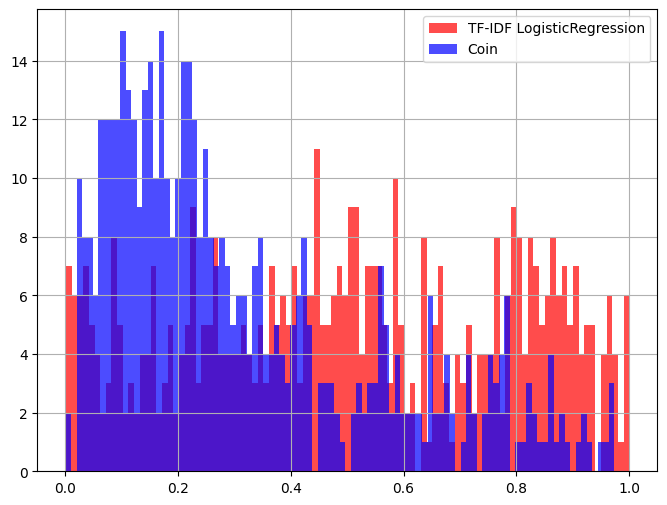

In [35]:
fif = plt.figure(figsize = (8, 6))

pd.Series(coin_predict)\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'r',
                      label = 'TF-IDF LogisticRegression'
                     )

pd.Series(predict_lr_base_proba[:, 1])\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'b',
                      label = 'Coin'
                     )
plt.legend()   
plt.show()

## Визуализация ROC

In [36]:
fpr_base, tpr_base, _ = roc_curve(test_df1['toxic'], predict_lr_base_proba[:, 1])
roc_auc_base = auc(fpr_base, tpr_base)

In [37]:
fpr_coin, tpr_coin, _ = roc_curve(test_df1['toxic'], coin_predict)
roc_auc_coin = auc(fpr_base, tpr_base)

In [38]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )



fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    #fill = 'tozeroy',
    name = "ROC base (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier (area = 0.5)'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

In [39]:
# матрицва ошибок
confusion_matrix(test_df1['toxic'],
                 (predict_lr_base_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.98250729, 0.01749271],
       [0.35031847, 0.64968153]])

## Важность признака

In [40]:
# Получим веса признаков, то есть множители 
# подобранные логистической регрессией 
# для каждого компонента вектора tf-idf

weights = pd.DataFrame({'words': tfidf.get_feature_names_out(),
                        'weights': model_lr_base.coef_.flatten()})
weights_min = weights.sort_values(by= 'weights')
weights_max = weights.sort_values(by= 'weights', ascending = False)

In [41]:
weights_min = weights_min[:100]
weights_min['weights'] = weights_min['weights'] * -1
weights_min

,words,weights
4192,год,3.560321
22252,спасибо,3.134203
15023,очень,3.008333
4322,город,2.906187
12218,например,2.775695
...,...,...
8653,клиент,1.316046
16869,пока,1.310548
26097,часть,1.309700
9041,конкурент,1.309007


In [42]:
weights_max = weights_max[:100]
weights_max

,words,weights
25771,хохол,5.840415
24091,тупой,4.769941
4811,дебил,4.674506
25741,хохлов,4.223352
26626,шлюха,4.089011
...,...,...
2199,ваш,1.604613
26302,чмо,1.603918
16005,пиндоса,1.594838
19116,пусть,1.586619


In [43]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_positive = WordCloud(background_color="black",
                               colormap = 'Reds',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_max.values))

wordcloud_negative = WordCloud(background_color="white",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_min.values))

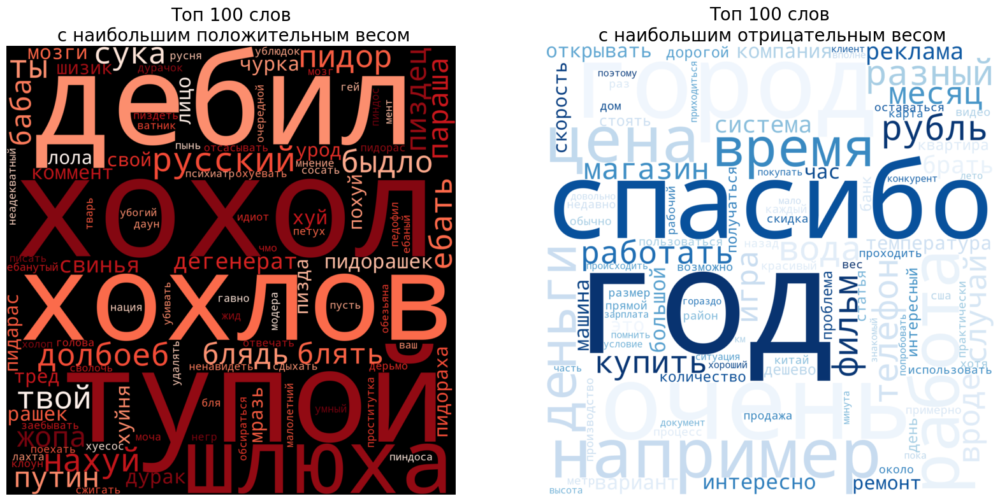

In [44]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))

ax[0].imshow(wordcloud_positive, interpolation='bilinear')
ax[1].imshow(wordcloud_negative, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(weights_max.shape[0]) +\
                ' слов\n с наибольшим положительным весом',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(weights_min.shape[0]) +\
                ' слов\n с наибольшим отрицательным весом',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

## Снижение размерности признакового пространства модели

In [45]:
fig = make_subplots(1,1)

fig.add_trace(go.Histogram(
    x = weights.query('weights != 0')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.add_trace(go.Histogram(
    x = weights.query('weights > 0.25 or weights < -0.25')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    
)

In [46]:
vocab = weights.query('weights > 0.25 or weights < -0.25')['words']
vocab

2             аааааа
5        ааааааааааа
8               аард
13              абга
40               абу
            ...     
27293       японский
27296          яркий
27298        яркость
27313            яша
27316           ящик
Name: words, Length: 4926, dtype: object

In [47]:
count_idf = TfidfVectorizer(vocabulary=vocab,
                            ngram_range=(1,1))

In [48]:
tf_idf = count_idf.fit_transform(df1['comment'])

tf_idf_train = count_idf.transform(train_df1['comment'])
tf_idf_test = count_idf.transform(test_df1['comment'])

In [49]:
display(tf_idf_test.shape)
display(tf_idf_train.shape)

(500, 4926)

(13912, 4926)

In [50]:
model_lr_base = LogisticRegression(solver='lbfgs', random_state=234, max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели на меньшей размерности

In [51]:
model_lr_base.fit(tf_idf_train, train_df1['toxic'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=234)

In [52]:
predict_lr_base_proba_1 = model_lr_base.predict_proba(tf_idf_test)

In [53]:
fpr_base_1, tpr_base_1, _ = roc_curve(test_df1['toxic'], predict_lr_base_proba_1[:, 1])
roc_auc_base_1 = auc(fpr_base_1, tpr_base_1)

In [54]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    fill = 'tozeroy',
    name = "ROC curve (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base_1,
    y = tpr_base_1,
    fill = 'tozeroy',
    name = "Less dimensity ROC curve (area = %0.3f)" % roc_auc_base_1,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

качество значительно уменьшилось

In [55]:
scores = {}

weight = 0.55

for threshold in np.linspace(0, 1, 100):
    
    matrix = confusion_matrix(test_df1['toxic'],
                 (predict_lr_base_proba[:, 0] <  threshold).astype('float'),
                 normalize='true',
                )

    score = matrix[0,0] * weight + matrix[1,1] * (1 - weight)
    
    scores[threshold] = score

In [56]:
pd.DataFrame({'true_score':scores.values(),
             'threshold':scores.keys()},
             ).sort_values(by = 'true_score', ascending = False).head()

,true_score,threshold
59,0.869215,0.595960
58,0.868293,0.585859
61,0.863723,0.616162
57,0.862901,0.575758
60,0.862801,0.606061


In [57]:
matrix = confusion_matrix(test_df1['toxic'],
                 (predict_lr_base_proba[:, 0] <  0.575758).astype('int'),
                 normalize='true',
                )
matrix

array([[0.95918367, 0.04081633],
       [0.25477707, 0.74522293]])

In [58]:
# Сделаем красивый график матрицы ошибок

fig = make_subplots(1,1)

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_annotation(x=0, y=0,
            text = "false negative " + str(round(matrix[1,0], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=1,
            text = "false positive " + str(round(matrix[0,1], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=0,
            text = "true positive " + str(round(matrix[1,1], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)

fig.add_annotation(x=0, y=1,
            text = "true negative " + str(round(matrix[0,0], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)


fig.update_layout(height = 500,
                  width = 500,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                 ).show()

## Улучшение модели

Попробуем подобрать коэффициен регуляризации с

In [59]:
pipeline = Pipeline([
    ("tfidf", TfidfVectorizer(
        lowercase=False,
        token_pattern=None,
        tokenizer=lambda x: x,       
        preprocessor=lambda x: x     
    )),
    ("clf", LogisticRegression(
        random_state=0,
        max_iter=1000,
        solver="lbfgs"               
    ))
])

param_grid = {
    # TF-IDF
    "tfidf__ngram_range": [(1,1), (1,2)],
    "tfidf__max_df": [0.8, 1.0],
    "tfidf__min_df": [1, 5],
    # LogisticRegression
    "clf__C": [0.1, 1, 10],
    "clf__penalty": ["l2"],
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)

grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    cv=cv,
    scoring="f1_macro",    # для несбалансированных классов
    verbose=2,
    n_jobs=-1,
    return_train_score=True
)

In [60]:
grid_search.fit(train_df1["comment"], train_df1["toxic"])

Fitting 5 folds for each of 24 candidates, totalling 120 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=0, shuffle=True),
             estimator=Pipeline(steps=[('tfidf',
                                        TfidfVectorizer(lowercase=False,
                                                        preprocessor=<function <lambda> at 0x000001C6B7E570D0>,
                                                        token_pattern=None,
                                                        tokenizer=<function <lambda> at 0x000001C6B7DDBAF0>)),
                                       ('clf',
                                        LogisticRegression(max_iter=1000,
                                                           random_state=0))]),
             n_jobs=-1,
             param_grid={'clf__C': [0.1, 1, 10], 'clf__penalty': ['l2'],
                         'tfidf__max_df': [0.8, 1.0], 'tfidf__min_df': [1, 5],
                         'tfidf__ngram_range': [(1, 1), (1, 2)]},
             return_train_score=True, scoring='f1_macro', verbose=2)

In [61]:
print("Лучшие параметры:", grid_search.best_params_)
print("Лучший f1_macro (CV):", grid_search.best_score_)

Лучшие параметры: {'clf__C': 10, 'clf__penalty': 'l2', 'tfidf__max_df': 0.8, 'tfidf__min_df': 1, 'tfidf__ngram_range': (1, 2)}
Лучший f1_macro (CV): 0.8283958069863147


In [62]:
# 6. Берём лучшую модель
best_model = grid_search.best_estimator_

# 7. Вычисляем precision-recall curve на тесте
y_true = test_df1["toxic"]
y_proba = best_model.predict_proba(test_df1["comment"])[:, 1]
precisions, recalls, thresholds = precision_recall_curve(y_true=y_true, probas_pred=y_proba)

# 8. Ищем threshold, при котором precision > 0.8 и recall максимально
idxs = np.where(precisions > 0.8)[0]
if idxs.size > 0:
    max_recall_idx = idxs[np.argmax(recalls[idxs])]
    best_threshold = thresholds[max_recall_idx]
    best_recall = recalls[max_recall_idx]
else:
    print("Не найден порог с precision > 0.8")

# 9. Оцениваем финальные метрики при выбранном пороге
if idxs.size > 0:
    y_pred = (y_proba > best_threshold).astype(int)
    final_precision = precision_score(y_true, y_pred)
    final_recall = recall_score(y_true, y_pred)
    print(f"Final precision: {final_precision:.4f}")
    print(f"Final recall:    {final_recall:.4f}")

Final precision: 0.8069
Final recall:    0.7452
